<a href="https://colab.research.google.com/github/kshitijmalvankar/CreativeAI/blob/main/CreativeAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing the libraries

In [1]:
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random 
import os
import PIL.Image
import cv2
import random
from PIL import Image 

# Loading the model with pre trained weights

In [2]:
base_model = tf.keras.applications.InceptionV3(include_top = False, weights = 'imagenet')

87916544/87910968 [==============================] - 1s 0us/step


In [3]:
# Open the first image
# Source: https://www.pxfuel.com/en/free-photo-xxgfs
img_1 = Image.open("mars.jpg")

# Open the second image
# Source: https://commons.wikimedia.org/wiki/File:Georges_Garen_embrasement_tour_Eiffel.jpg
img_2 = Image.open('eiffel.jpg')

# Blend the two images

image = Image.blend(img_1, img_2, 0.5) # alpha --> The interpolation alpha factor. If alpha is 0.0, a copy of the first image is returned.
# If alpha is 1.0, a copy of the second image is returned. 

# Save the blended image
image.save("img_0.jpg")

In [4]:
Sample_Image = tf.keras.preprocessing.image.load_img('img_0.jpg')

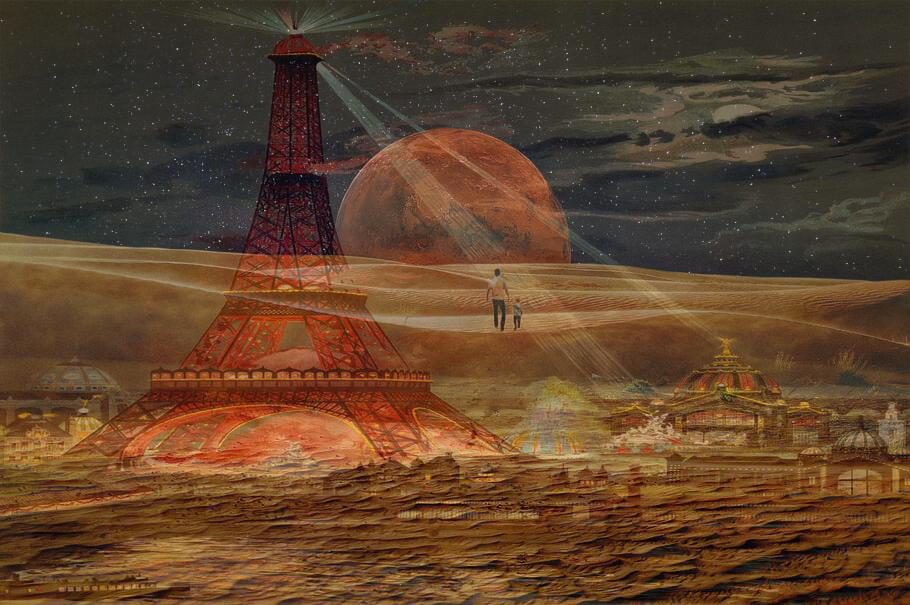

In [5]:
Sample_Image

In [6]:
# Get the shape of the image
np.shape(Sample_Image)

(605, 910, 3)

In [7]:
# Check out the type of the image
type(Sample_Image)

PIL.JpegImagePlugin.JpegImageFile

In [8]:
# Convert to numpy array
Sample_Image = tf.keras.preprocessing.image.img_to_array(Sample_Image)

# Sample_Image = np.array(Sample_Image)

In [9]:
# Confirm that the image is converted to Numpy array
type(Sample_Image)

numpy.ndarray

In [10]:
# Obtain the max and min values
print('min pixel values = {}, max pixel values = {}'.format(Sample_Image.min(), Sample_Image.max()))

min pixel values = 0.0, max pixel values = 255.0


In [11]:
# Normalize the input image
Sample_Image = np.array(Sample_Image)/255.0
Sample_Image.shape

(605, 910, 3)

In [12]:
# Let's verify normalized images values!
print('min pixel values = {}, max pixel values = {}'.format(Sample_Image.min(), Sample_Image.max()))

min pixel values = 0.0, max pixel values = 1.0


In [13]:
Sample_Image = tf.expand_dims(Sample_Image, axis = 0)

In [14]:
np.shape(Sample_Image)

TensorShape([1, 605, 910, 3])

# Running the pretrained model

In [15]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

In [16]:
# Maximize the activations of these layers

names = ['mixed3', 'mixed5', 'mixed7']

# names = ['mixed3']

layers = [base_model.get_layer(name).output for name in names]

# Create the feature extraction model
deepdream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

In [17]:
deepdream_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [18]:
# Let's run the model by feeding in our input image and taking a look at the activations "Neuron outputs"
activations = deepdream_model(Sample_Image)
activations

[<tf.Tensor: shape=(1, 36, 55, 768), dtype=float32, numpy=
 array([[[[0.        , 0.        , 0.        , ..., 0.02111783,
           0.42713752, 0.30679747],
          [0.        , 0.13667202, 0.        , ..., 0.        ,
           0.        , 0.        ],
          [0.        , 0.25661922, 0.        , ..., 0.        ,
           0.07347673, 0.        ],
          ...,
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.        ],
          [0.        , 0.        , 0.        , ..., 0.42646694,
           0.        , 0.        ],
          [0.05945684, 0.        , 0.        , ..., 0.42646694,
           0.6412617 , 0.        ]],
 
         [[0.67514175, 0.        , 0.        , ..., 0.02111783,
           0.28741282, 0.65448624],
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.22241244],
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.        ],
          ...,
        

In [19]:
len(activations)

3

# Performing Gradient calculations

In [20]:
x = tf.constant(2.0)

In [21]:
with tf.GradientTape() as g:
  g.watch(x)
  y = x * x * x
dy_dx = g.gradient(y, x) # Will compute to 12

In [22]:
dy_dx

<tf.Tensor: shape=(), dtype=float32, numpy=12.0>

In [23]:
x = tf.constant(5.0)

In [24]:
with tf.GradientTape() as g:
  g.watch(x)
  y = (x * x * x * x) + (x * x * x * x * x)  
dy_dx = g.gradient(y, x) 
dy_dx

<tf.Tensor: shape=(), dtype=float32, numpy=3625.0>

# Implementing DeepDream Algorithm

In [26]:
# Since the cal_closs function includes expand dimension, let's squeeze the image (reduce_dims)
Sample_Image.shape

TensorShape([1, 605, 910, 3])

In [27]:
Sample_Image = tf.squeeze(Sample_Image, axis = 0)

In [28]:
Sample_Image.shape

TensorShape([605, 910, 3])

In [29]:
def calc_loss(image, model):
# Function used for loss calculations
# It works by feedforwarding the input image through the network and generate activations
# Then obtain the average and sum of those outputs

  img_batch = tf.expand_dims(image, axis=0) # Convert into batch format
  layer_activations = model(img_batch) # Run the model
  print('ACTIVATION VALUES (LAYER OUTPUT) =\n', layer_activations)
  # print('ACTIVATION SHAPE =\n', np.shape(layer_activations))

  losses = [] # accumulator to hold all the losses
  for act in layer_activations:
    loss = tf.math.reduce_mean(act) # calculate mean of each activation 
    losses.append(loss)
  
  print('LOSSES (FROM MULTIPLE ACTIVATION LAYERS) = ', losses)
  print('LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) = ', np.shape(losses))
  print('SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)= ', tf.reduce_sum(losses))

  return  tf.reduce_sum(losses) # Calculate sum 

In [30]:
loss = calc_loss(tf.Variable(Sample_Image), deepdream_model)

ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor: shape=(1, 36, 55, 768), dtype=float32, numpy=
array([[[[0.        , 0.        , 0.        , ..., 0.02111783,
          0.42713752, 0.30679747],
         [0.        , 0.13667202, 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.25661922, 0.        , ..., 0.        ,
          0.07347673, 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.42646694,
          0.        , 0.        ],
         [0.05945684, 0.        , 0.        , ..., 0.42646694,
          0.6412617 , 0.        ]],

        [[0.67514175, 0.        , 0.        , ..., 0.02111783,
          0.28741282, 0.65448624],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.22241244],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
       

In [31]:
@tf.function
def deepdream(model, image, step_size):
    with tf.GradientTape() as tape:
      # This needs gradients relative to `img`
      # `GradientTape` only watches `tf.Variable`s by default
      tape.watch(image)
      loss = calc_loss(image, model) # call the function that calculate the loss 

    # Calculate the gradient of the loss with respect to the pixels of the input image.
    # The syntax is as follows: dy_dx = g.gradient(y, x) 
    gradients = tape.gradient(loss, image)

    print('GRADIENTS =\n', gradients)
    print('GRADIENTS SHAPE =\n', np.shape(gradients))

    # tf.math.reduce_std computes the standard deviation of elements across dimensions of a tensor
    gradients /= tf.math.reduce_std(gradients)  

    # In gradient ascent, the "loss" is maximized so that the input image increasingly "excites" the layers.
    # You can update the image by directly adding the gradients (because they're the same shape!)
    image = image + gradients * step_size
    image = tf.clip_by_value(image, -1, 1)

    return loss, image

In [32]:
def run_deep_dream_simple(model, image, steps = 100, step_size = 0.01):
  # Convert from uint8 to the range expected by the model.
  image = tf.keras.applications.inception_v3.preprocess_input(image)

  for step in range(steps):
    loss, image = deepdream(model, image, step_size)
    
    if step % 100 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(deprocess(image))
      plt.show()
      print ("Step {}, loss {}".format(step, loss))

  # clear_output(wait=True)
  plt.figure(figsize=(12,12))
  plt.imshow(deprocess(image))
  plt.show()

  return deprocess(image)

In [33]:
def deprocess(image):
  image = 255*(image + 1.0)/2.0
  return tf.cast(image, tf.uint8)

ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor 'model/mixed3/concat:0' shape=(1, 36, 55, 768) dtype=float32>, <tf.Tensor 'model/mixed5/concat:0' shape=(1, 36, 55, 768) dtype=float32>, <tf.Tensor 'model/mixed7/concat:0' shape=(1, 36, 55, 768) dtype=float32>]
LOSSES (FROM MULTIPLE ACTIVATION LAYERS) =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) =  (3,)
SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)=  Tensor("Sum:0", shape=(), dtype=float32)
GRADIENTS =
 Tensor("gradient_tape/Reshape_4:0", shape=(605, 910, 3), dtype=float32)
GRADIENTS SHAPE =
 (605, 910, 3)


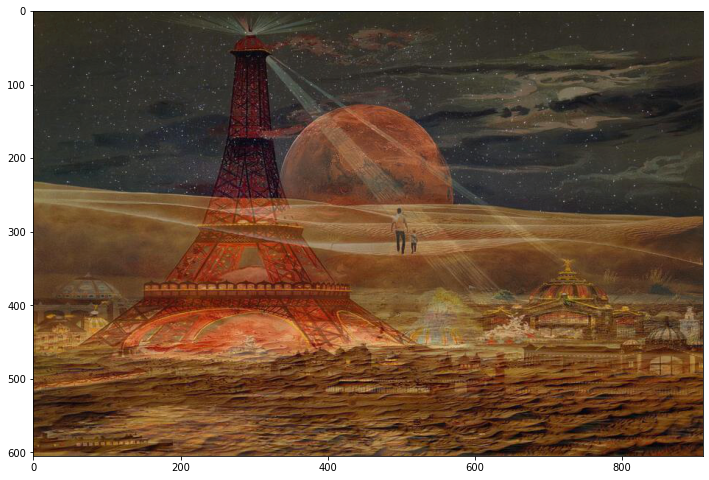

Step 0, loss 0.5804304480552673


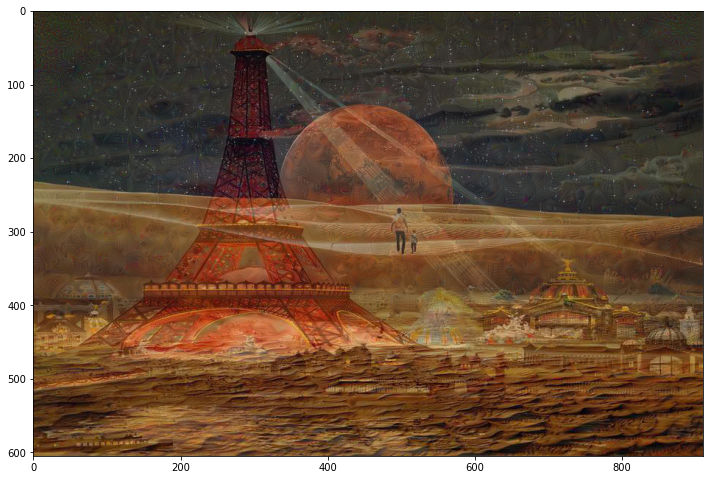

Step 100, loss 1.2817728519439697


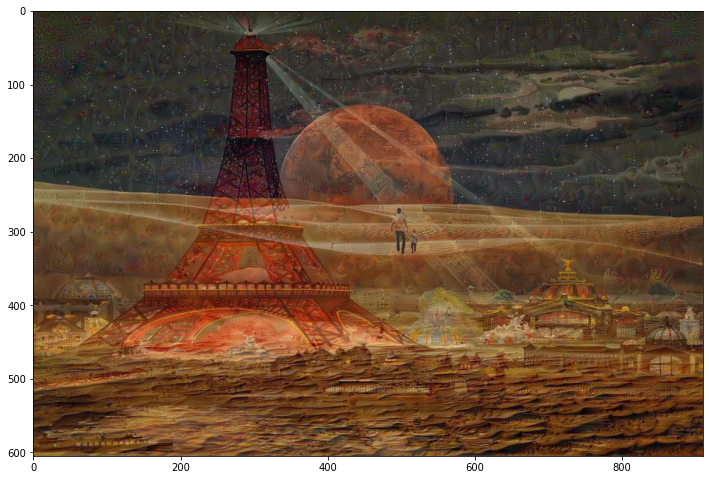

Step 200, loss 1.5005748271942139


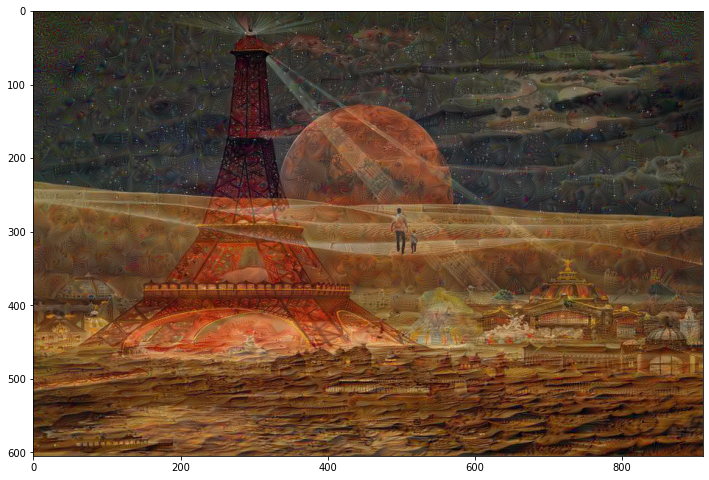

Step 300, loss 1.6384549140930176


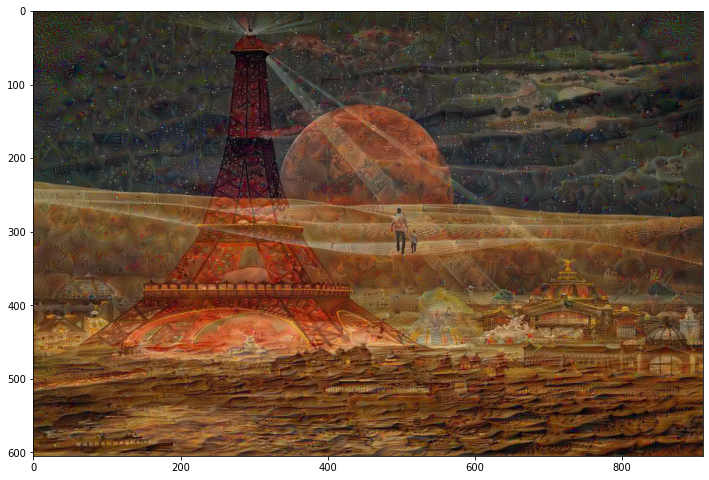

Step 400, loss 1.7396016120910645


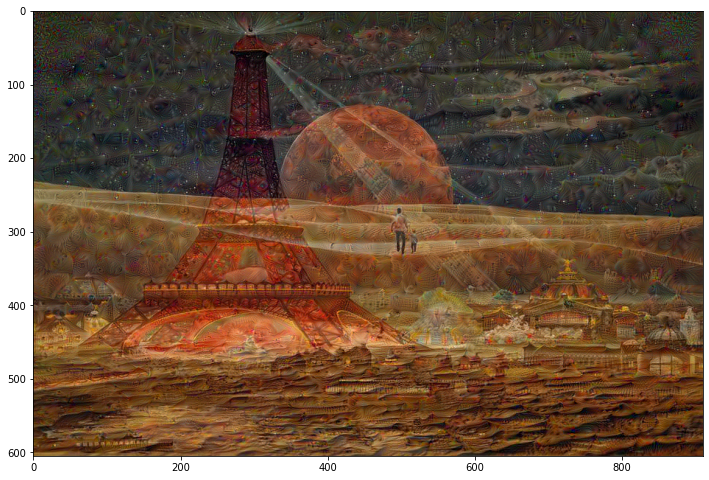

Step 500, loss 1.821390151977539


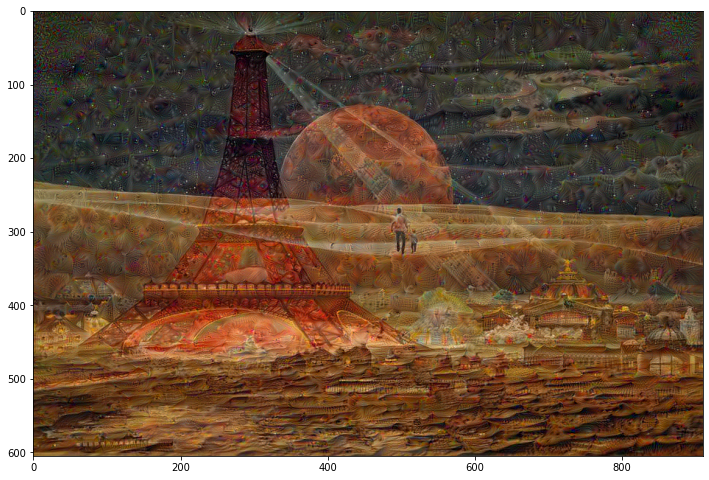

Step 600, loss 1.8910937309265137


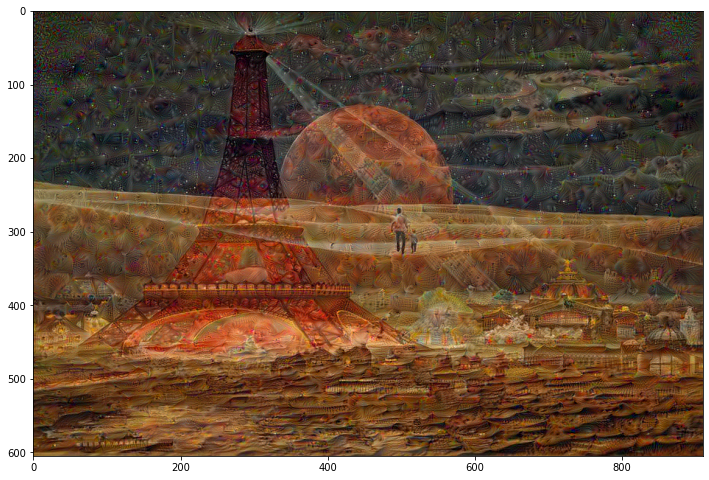

Step 700, loss 1.9508529901504517


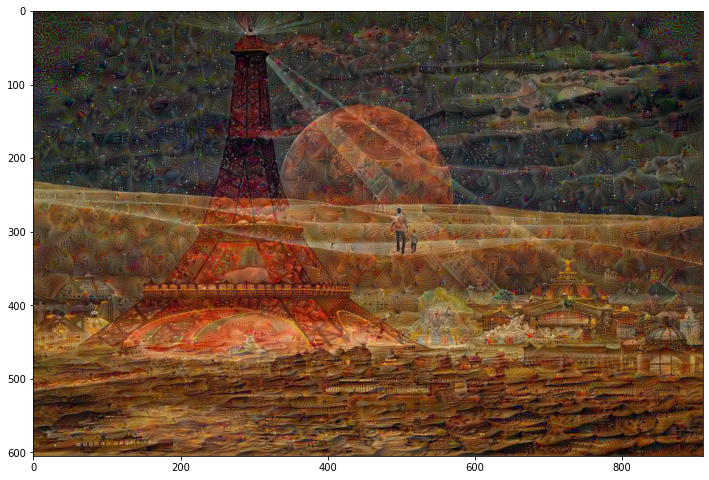

Step 800, loss 2.0051932334899902


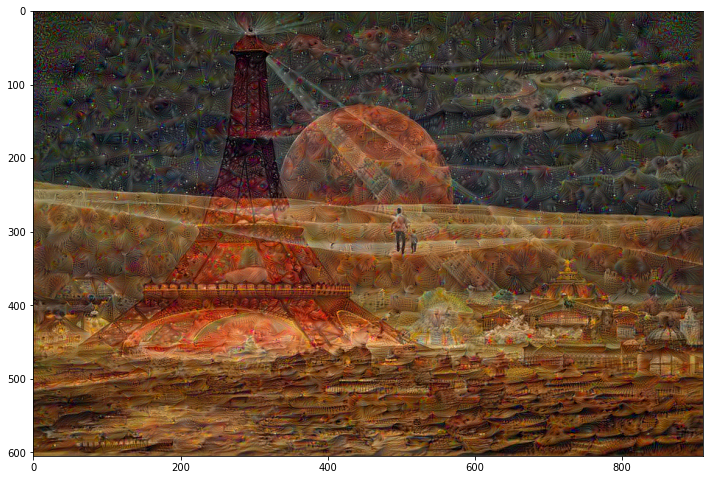

Step 900, loss 2.0528619289398193


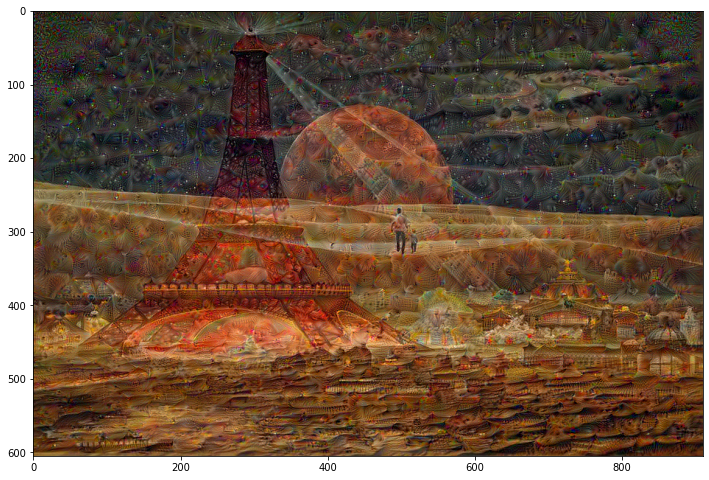

Step 1000, loss 2.0958619117736816


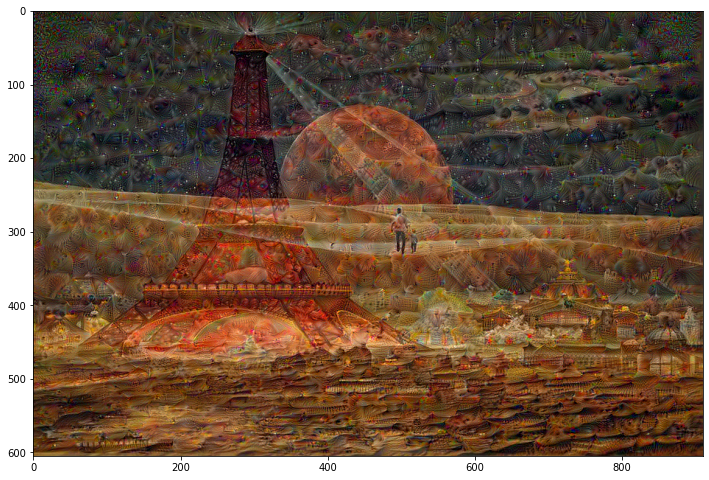

Step 1100, loss 2.134533166885376


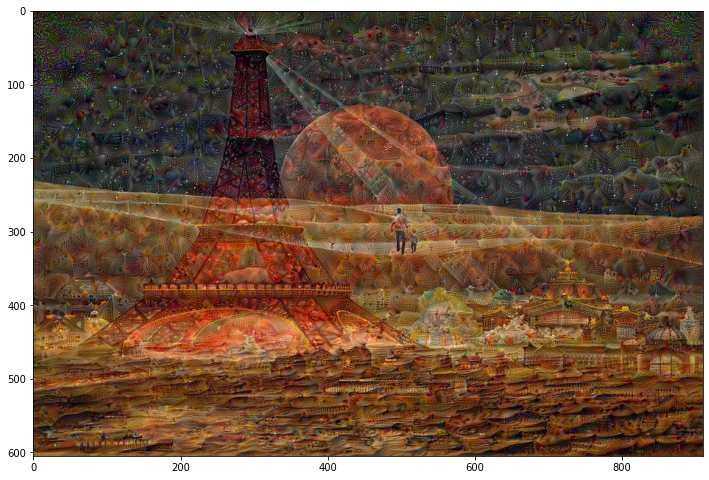

Step 1200, loss 2.170319080352783


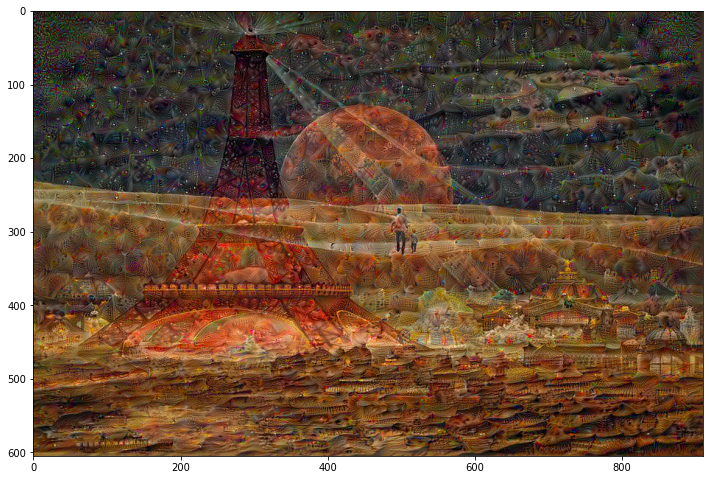

Step 1300, loss 2.203146457672119


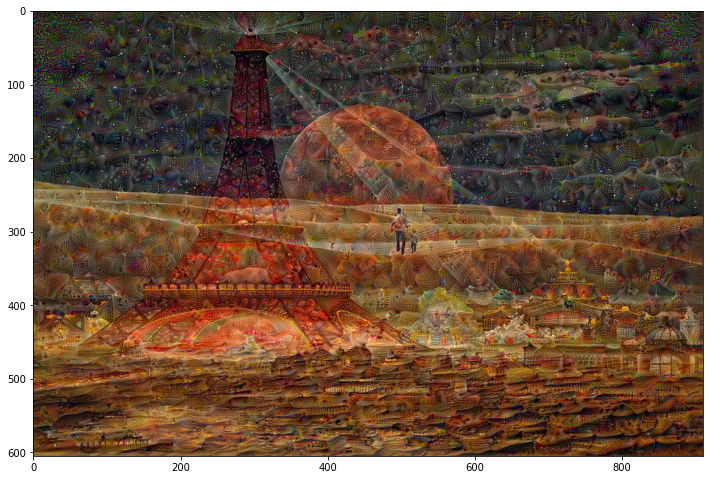

Step 1400, loss 2.234212875366211


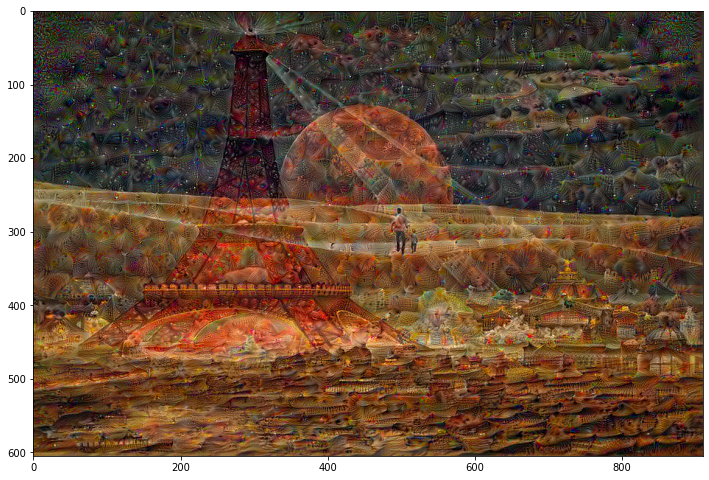

Step 1500, loss 2.2627553939819336


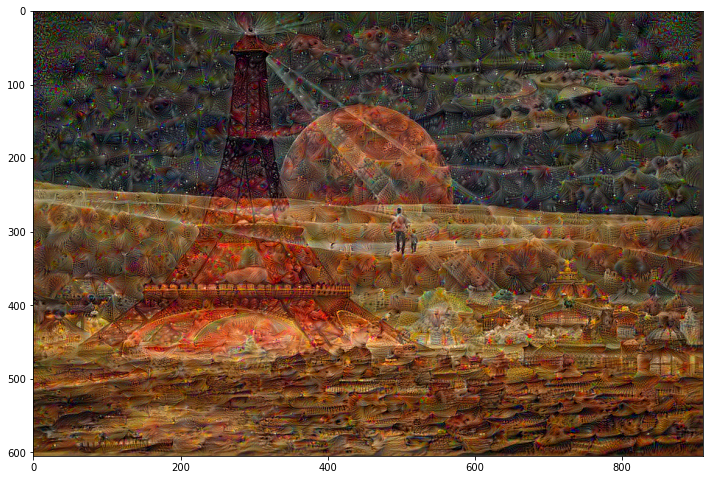

Step 1600, loss 2.29042387008667


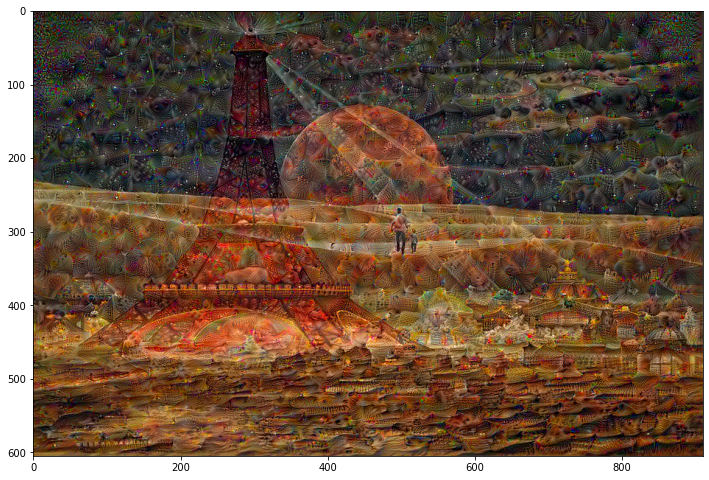

Step 1700, loss 2.316129684448242


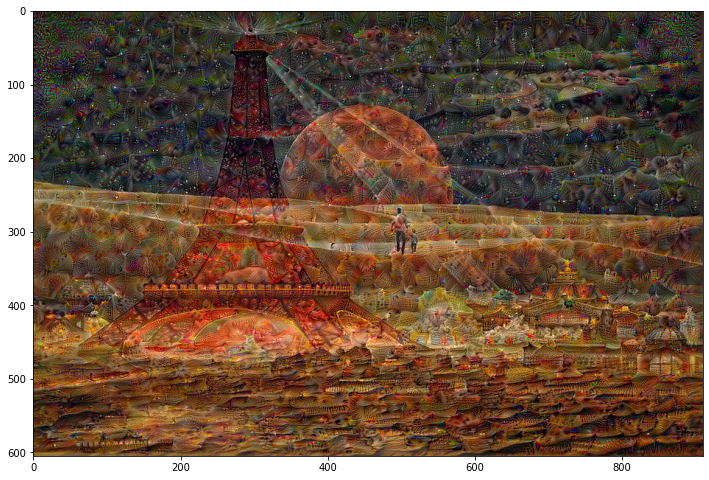

Step 1800, loss 2.3408708572387695


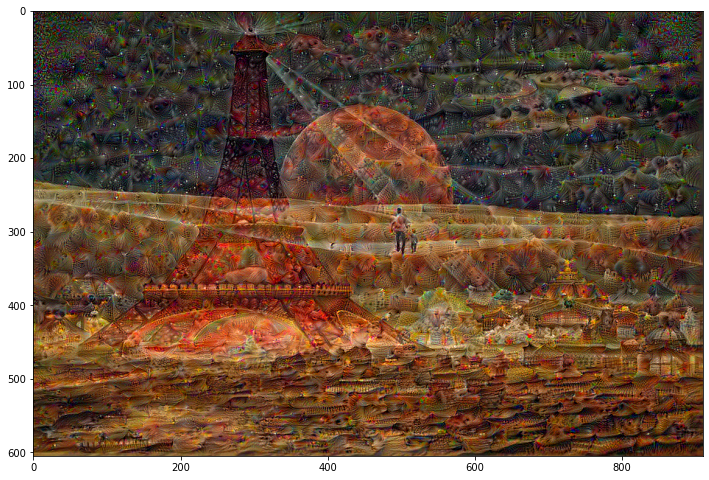

Step 1900, loss 2.3643293380737305


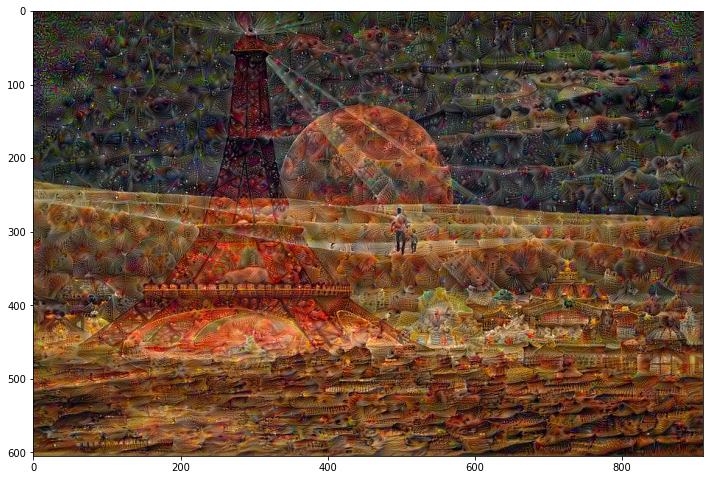

Step 2000, loss 2.38651180267334


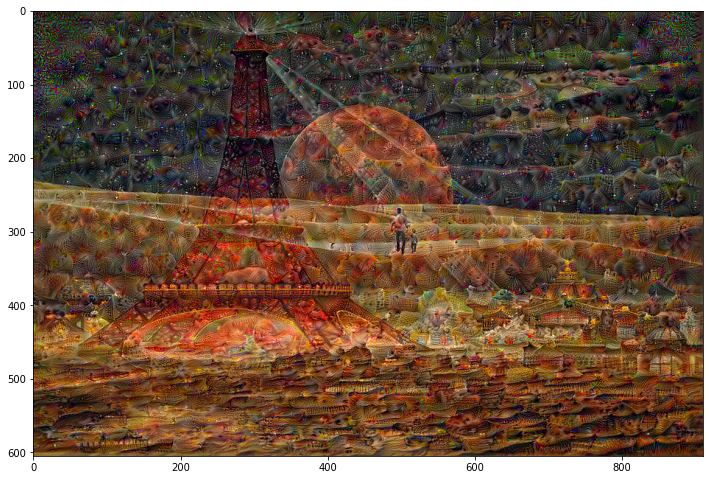

Step 2100, loss 2.407757043838501


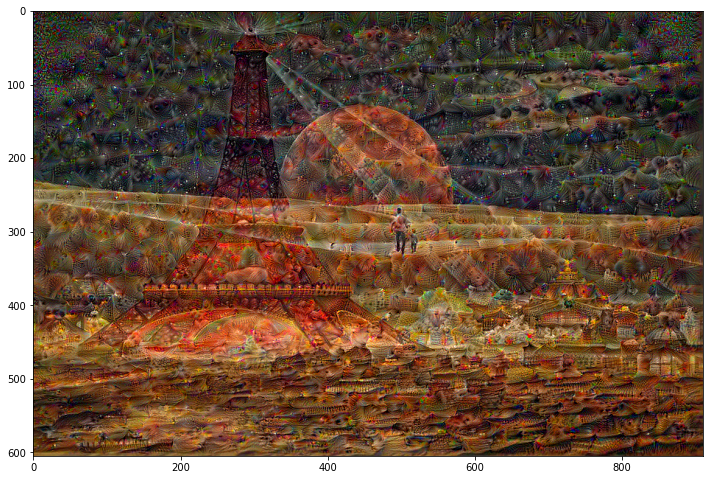

Step 2200, loss 2.4279990196228027


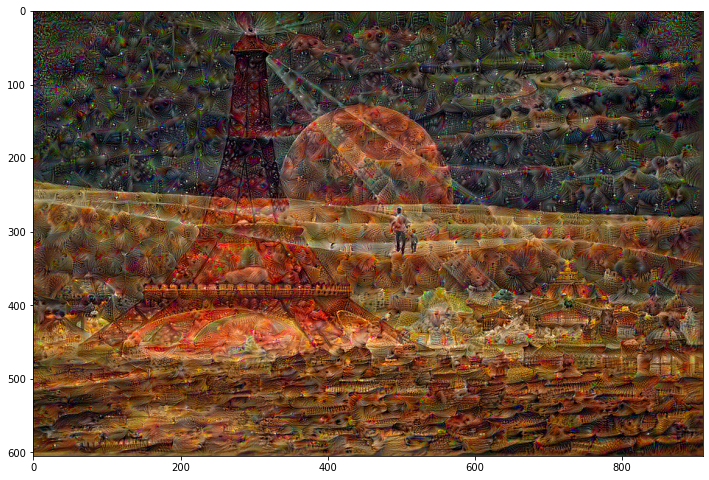

Step 2300, loss 2.447890281677246


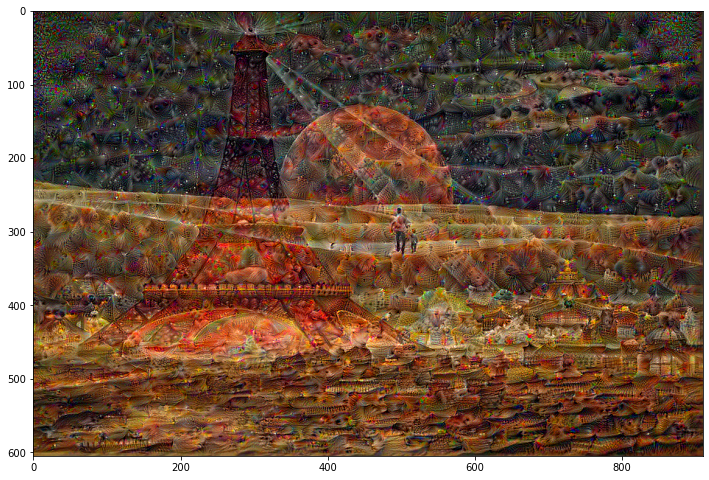

Step 2400, loss 2.46705961227417


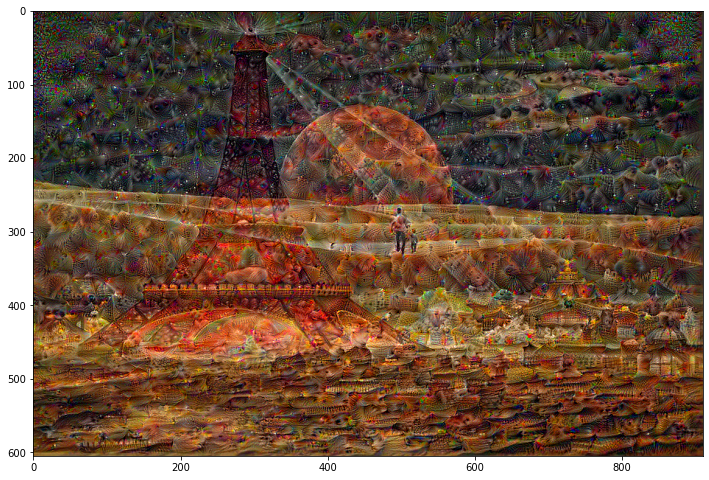

Step 2500, loss 2.485792398452759


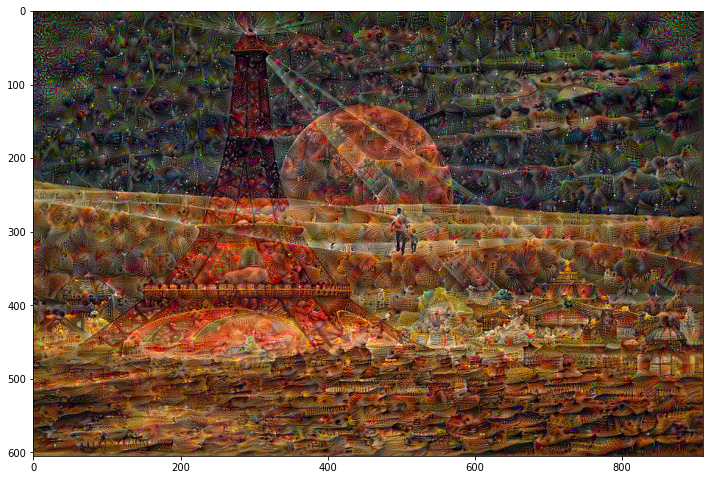

Step 2600, loss 2.5037786960601807


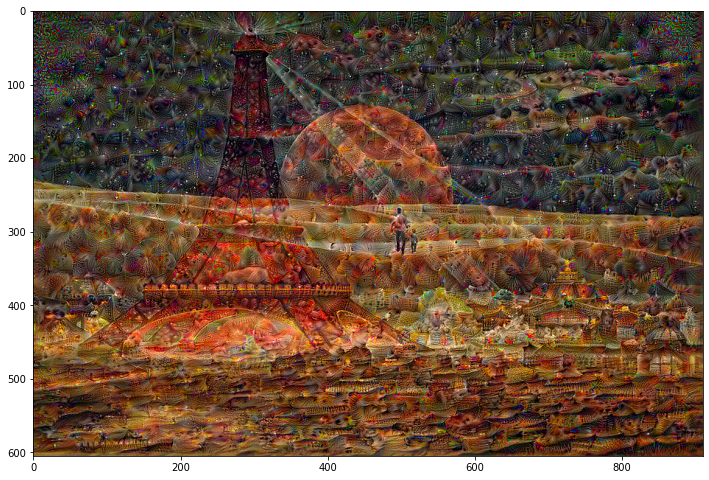

Step 2700, loss 2.521393060684204


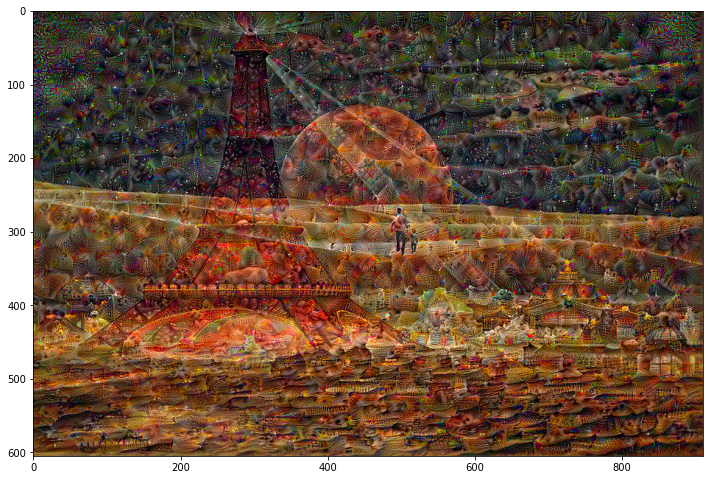

Step 2800, loss 2.538187026977539


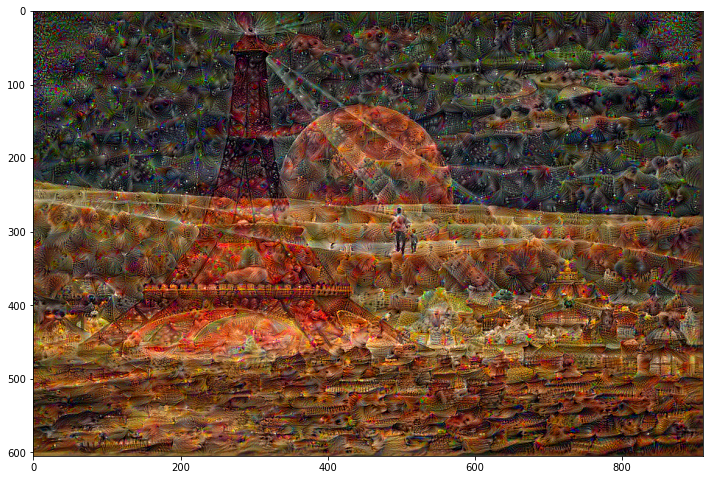

Step 2900, loss 2.5545310974121094


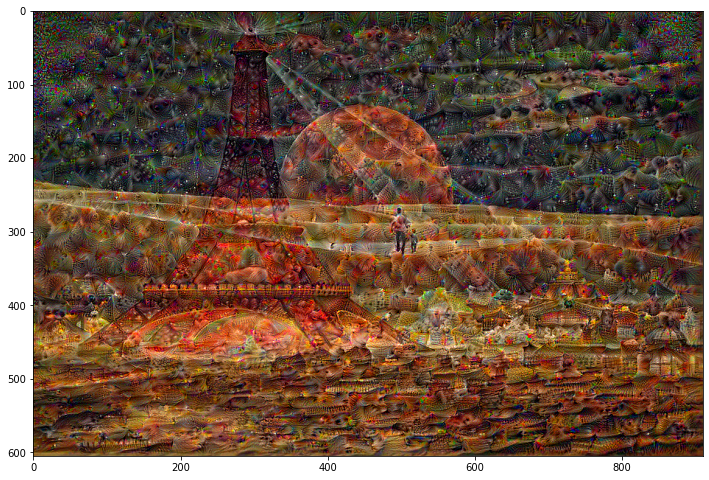

Step 3000, loss 2.5704238414764404


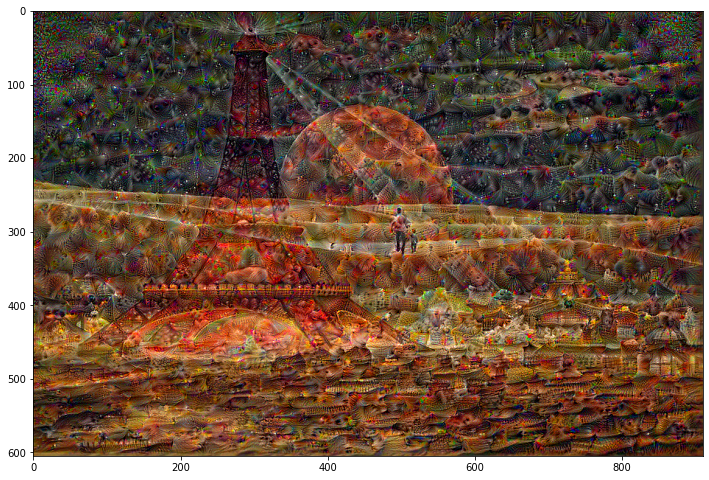

Step 3100, loss 2.585850238800049


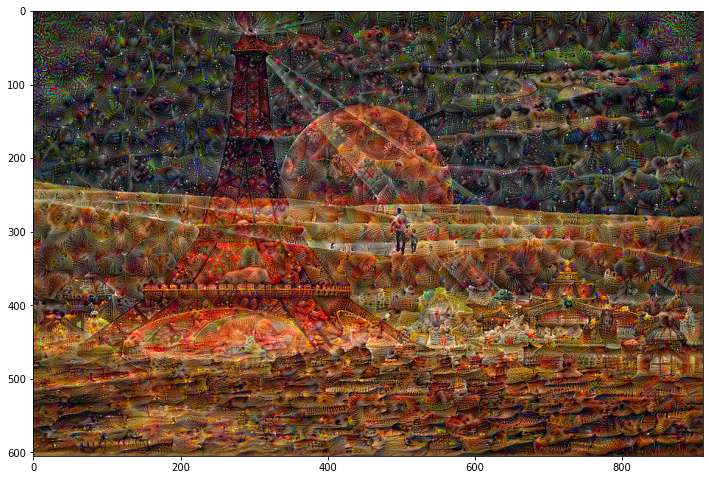

Step 3200, loss 2.60064435005188


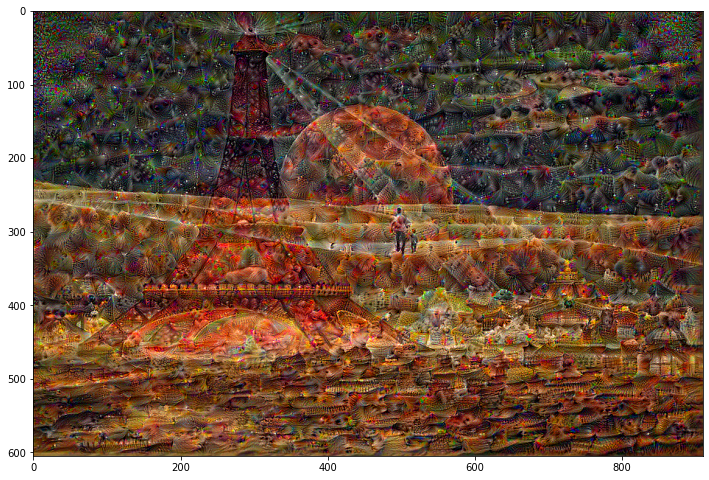

Step 3300, loss 2.6158485412597656


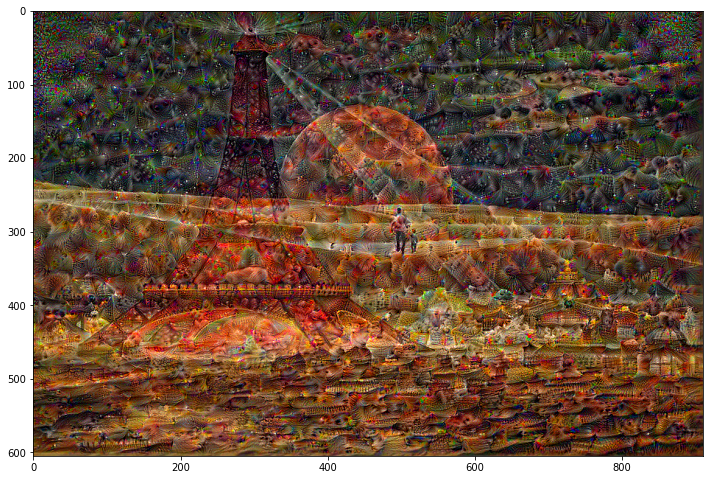

Step 3400, loss 2.6303389072418213


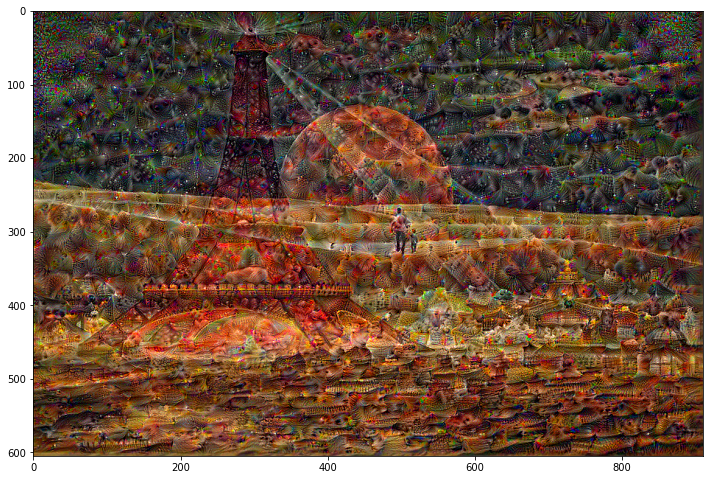

Step 3500, loss 2.6446261405944824


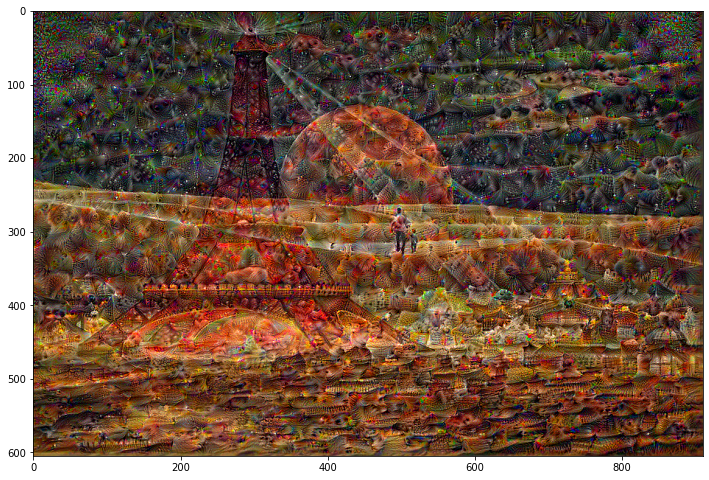

Step 3600, loss 2.6586062908172607


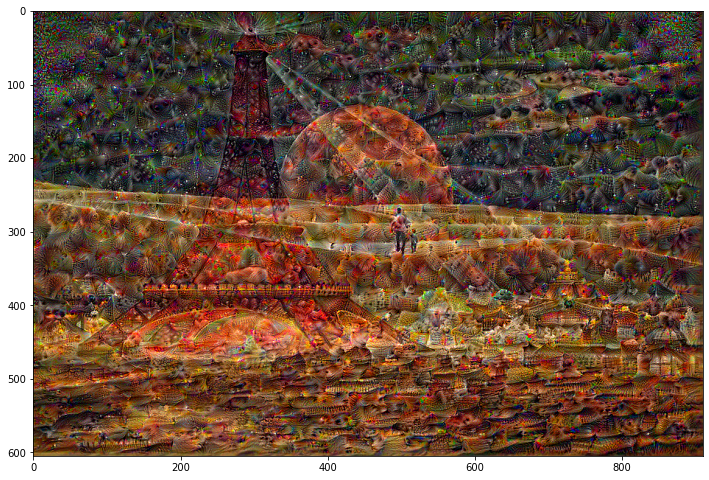

Step 3700, loss 2.6722452640533447


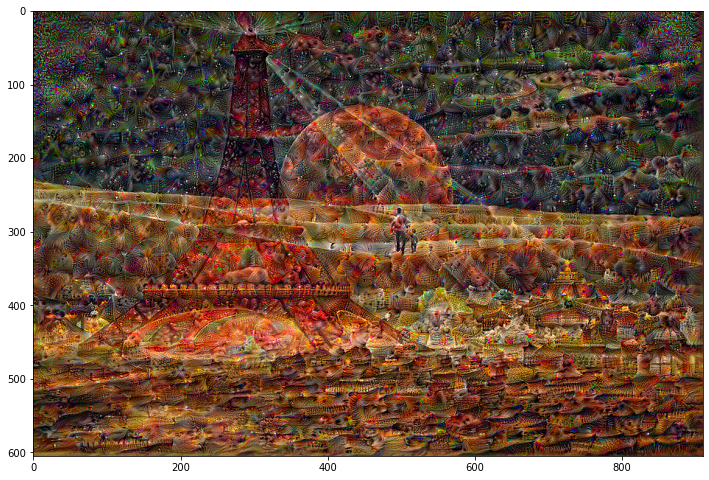

Step 3800, loss 2.685817241668701


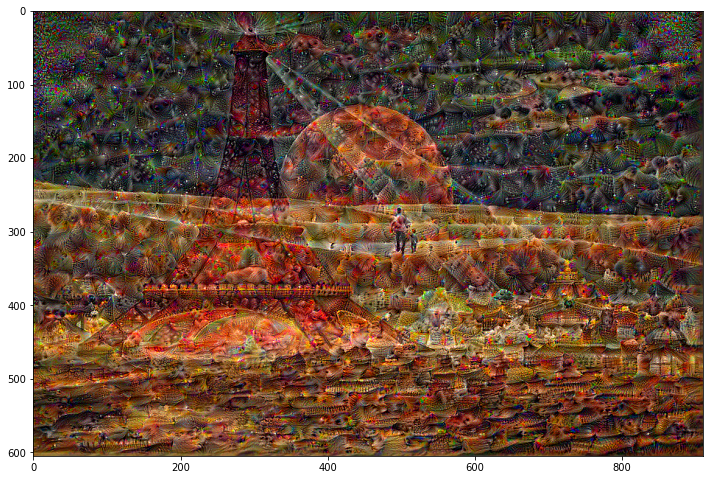

Step 3900, loss 2.698930025100708


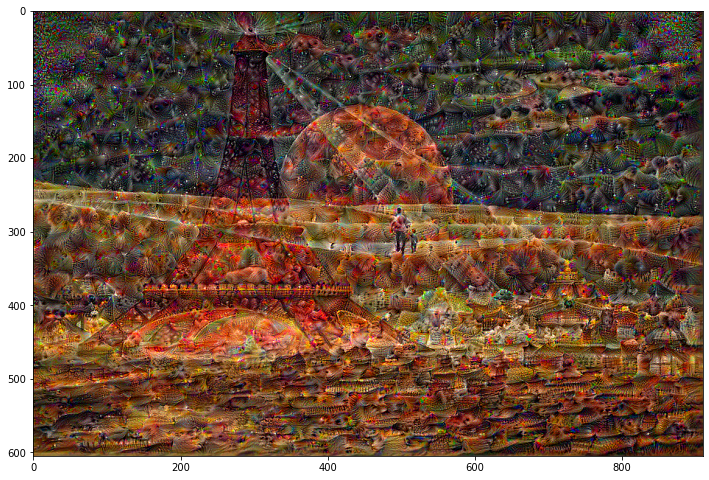

In [34]:
Sample_Image = np.array(tf.keras.preprocessing.image.load_img('img_0.jpg'))
dream_img = run_deep_dream_simple(model = deepdream_model, image = Sample_Image, steps = 4000, step_size = 0.001)
